In [1]:
# -*- coding: utf-8 -*-
import quandl
import numpy as np
import statsmodels.api as sm
from scipy import stats
import matplotlib
from matplotlib import cm, pyplot as plt
from hmmlearn.hmm import GaussianHMM
import scipy
import datetime
import json
import seaborn as sns
# from sklearn.externals import joblib
import pandas as pd
import joblib
from backtest_func import yearsharpRatio, maxRetrace, annROR
import copy
import warnings
warnings.filterwarnings("ignore")

In [21]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [2]:
class Alphas(object):
    def __init__(self, pn_data):
        """
        :传入参数 pn_data: pandas.Panel
        """
        # 获取历史数据
        self.open = pn_data['open']
        self.high = pn_data['high']
        self.low = pn_data['low']
        self.close = pn_data['close']
        self.volume = pn_data['volume']
        # self.amount=pn_data['amount']
        # self.returns = self.close-self.close.shift(1)

    def alpha000(self):
        data_m=self.close.rolling(10).apply(values_deviation, raw=True)
        return data_m

In [3]:
# 特征工程和建模
def get_best_hmm_model(X, max_states, max_iter=10000):
    best_score = -(10**10)
    best_state = 0

    for state in range(1, max_states + 1):
        hmm_model = GaussianHMM(n_components=state, random_state=100, covariance_type='diag',
                                n_iter=max_iter).fit(X)
        if hmm_model.score(X) > best_score:
            best_score = hmm_model.score(X)
            best_state = state
    best_model = GaussianHMM(n_components=best_state, random_state=100, covariance_type='diag', n_iter=max_iter).fit(X)
    return best_model

# Normalizde
def std_normallized(vals):
    return np.std(vals) / np.mean(vals)


# Ratio of diff
def ma_ratio(vals):
    return (vals[-1] - np.mean(vals)) / vals[-1]


# z-score
def values_deviation(vals):
    return (vals[-1] - np.mean(vals)) / np.std(vals)


#获取集合的所有子集
def PowerSetsRecursive(items):
    result = [[]]
    for x in items:
        result.extend([subset + [x] for subset in result])
    return result

In [4]:
class DataFactory(object):
    def __init__(self, instrument, factor_lst, future_period, s_date, e_date):
        self.instrument=instrument
        self.s_date=s_date
        self.e_date=e_date
        self.factor_lst=factor_lst
        self.future_period=future_period
        
    # 获取行情数据
    def get_history(self):
        data_ori = pd.read_csv('C:/e/data/future_index/' + self.instrument + '_daily_index.csv')
        data_ori['date_time'] = data_ori['date_time'].apply(lambda x: pd.to_datetime(x).strftime('%Y-%m-%d'))
        data_ori.index = data_ori['date_time']
        data_ori['close_1'] = data_ori['close'].shift(1)
        data_ori = data_ori.loc[self.s_date:self.e_date, :]
        return data_ori
    
    # 获取训练集初始数据
    def get_dataset(self):
        data_ori = self.get_history()
        dataset = data_ori.loc[:, ['open', 'high', 'low', 'close', 'volume']]
        for alpha in self.factor_lst:
            alpha = 'Alpha.' + alpha
            Alpha = Alphas(dataset)
            dataset[alpha[-8:]] = eval(alpha)()
        dataset = dataset.replace([np.inf, -np.inf], np.nan)
        dataset = pd.concat([dataset[self.factor_lst], data_ori[['high', 'low', 'close', 'volume', 'open', 'date_time', 'close_1']]], axis=1)
        #日涨跌幅，模型训练的Y值
        dataset['ret'] = dataset['close'].shift(-self.future_period) / dataset['close'] - 1
        dataset['ret'] = dataset['ret'].fillna(0)
        dataset = dataset.dropna()
        return dataset


In [5]:
class HmmStrategy(object):
    def __init__(self, asset, s_date, max_states, leverage, fee, data_set, cols_features, train_days=90, test_days=60,
                 insample=False, **kwargs):
        self.asset=asset
        self.s_date=s_date
        self.test_days=test_days
        self.train_days=train_days
        self.max_states=max_states
        self.leverage=leverage
        self.fee=fee
        self.data_set=data_set
        self.cols_features=cols_features
        self.insample = insample
        self.ret = pd.DataFrame()
        self.signal_state_all = pd.DataFrame()
        self.annR = 0
        self.sharp = 0
        self.max_retrace = 0
    
    # 隐状态定义涨跌：单一状态下累计损益为正即为看涨信号，反之为看跌信号
    def get_longshort_state_from_cumsum(self, dataset):
        dataset['date_time'] = pd.to_datetime(dataset['date_time'])
        net_new = copy.deepcopy(dataset).dropna()
        X = np.column_stack([net_new.loc[:, self.cols_features]])
        model = self.get_best_hmm_model(X)
        hidden_states = model.predict(X)
        long_states = []
        short_states = []
        random_states = []
        for k in range(model.n_components):
            idx = (hidden_states == k)
            idx_int = idx.astype(int)
            net_new['%dth_hidden_state' % k] = idx_int
            net_new['%dth_ret' % k] = net_new['%dth_hidden_state' % k] * net_new['ret']
            if net_new['%dth_ret' % k].sum() > 0:
                long_states.append(k)
            elif net_new['%dth_ret' % k].sum() < 0:
                short_states.append(k)
            elif net_new['%dth_ret' % k].sum() == 0:
                random_states.append(k)
#         print('做多隐状态：%s, 做空隐状态：%s, 空仓隐状态：%s' %(long_states, short_states, random_states))
        return model, hidden_states, long_states, short_states, random_states
    
    
    def get_best_hmm_model(self, X, max_iter=10000):
        best_score = -(10**10)
        best_state = 0
        for state in range(1, self.max_states + 1):
            hmm_model = GaussianHMM(n_components=state, random_state=100, covariance_type='diag',
                                    n_iter=max_iter).fit(X)
            try:
                if hmm_model.score(X) > best_score:
                    best_score = hmm_model.score(X)
                    best_state = state
            except:
                continue
        best_model = GaussianHMM(n_components=best_state, random_state=100, covariance_type='diag', n_iter=max_iter).fit(X)
        return best_model
    
    def handle_data(self, test_set, model, hidden_states, long_states, short_states, random_states):
        test_set['state'] = hidden_states[-len(test_set):]
        fee = self.fee
        state = None 
        signal_lst = []
        trad_times = 0
        chg = 0
        chg_lst = []
        pos_lst = []
        pos = 0
        low_price_pre = 0
        high_price_pre = 100000000
        long_stop = False
        short_stop = False
        state_lst = []
        for idx, _row in test_set.iterrows():
            test_data = test_set[self.cols_features].loc[:idx, :]
            state = _row.state
            state_lst.append(state)
            if pos == 0:
                if state in long_states:
                    pos = 1    
                    cost = _row.close * (1 + fee)
                    s_time = _row.date_time
                    hold_price = []
                    high_price = []
                    hold_price.append(cost/(1+fee))
                    high_price.append(cost/(1+fee))
                    high_price.append(_row.high)
                    chg = (pos * _row.close / cost + (1 - pos)) - 1 
                elif state in short_states:
                    cost = _row.close * (1 - fee)
                    pos = -1
                    s_time = _row.date_time
                    hold_price = []
                    low_price = []
                    hold_price.append(cost/(1-fee))
                    low_price.append(cost/(1-fee))
                    low_price.append(_row.low)
                    chg = ((1 + pos) - pos * (2 - _row.close / cost)) - 1
                else:
                    chg = 0
            elif pos > 0:
                if state in short_states:
                    s_price = _row.close * (1 - fee)
                    trad_times += 1
                    net1 = pos * s_price / _row.close_1 + (1 - pos)
                    ret = s_price / cost - 1
                    e_time = _row.date_time
                    signal_row = []
                    signal_row.append(s_time)
                    signal_row.append(e_time)
                    signal_row.append(cost)
                    signal_row.append(s_price)
                    signal_row.append(ret)
                    signal_row.append((max(high_price) / cost) - 1)
                    signal_row.append(len(hold_price))
                    signal_row.append(pos)
                    signal_row.append('spk')
                    signal_lst.append(signal_row)
                    s_time = _row.date_time
                    cost = s_price
                    pos = -1
                    net2 = (1 + pos) - pos * (2 - _row.close / cost)
                    hold_price = []
                    low_price = []
                    hold_price.append(cost/(1-fee))
                    low_price.append(cost/(1-fee))
                    low_price.append(_row.low)
                    chg = net1 * net2 - 1
                    short_stop = False
                    long_stop = False
                elif state in random_states:
                    s_price = _row.close * (1 - fee)
                    trad_times += 1
                    net1 = pos * s_price / _row.close_1 + (1 - pos)
                    ret = s_price / cost - 1
                    e_time = _row.date_time
                    signal_row = []
                    signal_row.append(s_time)
                    signal_row.append(e_time)
                    signal_row.append(cost)
                    signal_row.append(s_price)
                    signal_row.append(ret)
                    signal_row.append((max(high_price) / cost) - 1)
                    signal_row.append(len(hold_price))
                    signal_row.append(pos)
                    signal_row.append('sp')
                    signal_lst.append(signal_row)
                    pos = 0
                    high_price.append(_row.high)
                    long_stop = False
                    short_stop = False
                    chg = net1 - 1
                else:
                    high_price.append(_row.high)
                    hold_price.append(_row.close)
                    chg = (pos * _row.close / _row.close_1 + (1 - pos)) - 1
            elif pos < 0:
                if state in long_states:
                    b_price = _row.close * (1 + fee)
                    e_time = _row.date_time
                    trad_times += 1
                    net1 = (1 + pos) - pos * (2 - b_price / _row.close_1)
                    ret = (cost - b_price) / cost
                    signal_row = []
                    signal_row.append(s_time)
                    signal_row.append(e_time)
                    signal_row.append(cost)
                    signal_row.append(b_price)
                    signal_row.append(ret)
                    signal_row.append((cost - min(low_price)) / cost)
                    signal_row.append(len(hold_price))
                    signal_row.append(pos)
                    signal_row.append('bpk')
                    signal_lst.append(signal_row)
                    pos = 1
                    cost = b_price
                    net2 = pos * _row.close / cost + 1 - pos
                    s_time = _row.date_time
                    hold_price = []
                    high_price = []
                    hold_price.append(cost/(1+fee))
                    high_price.append(cost/(1+fee))
                    high_price.append(_row.high)
                    chg = net1 * net2 - 1
                    short_stop = False
                    long_stop = False
                elif state in random_states:
                    b_price = _row.close * (1 + fee)
                    trad_times += 1
                    net1 = (1 + pos) - pos * (2 - b_price / _row.close_1)
                    ret = (cost - b_price) / cost
                    e_time = _row.date_time
                    signal_row = []
                    signal_row.append(s_time)
                    signal_row.append(e_time)
                    signal_row.append(cost)
                    signal_row.append(b_price)
                    signal_row.append(ret)
                    signal_row.append((cost - min(low_price)) / cost)
                    signal_row.append(len(hold_price))
                    signal_row.append(pos)
                    signal_row.append('bp')
                    signal_lst.append(signal_row)
                    pos = 0
                    low_price.append(_row.low)
                    long_stop = False
                    short_stop = False
                    chg = net1 - 1

                else:
                    low_price.append(_row.low)
                    hold_price.append(_row.close)
                    chg = ((1 + pos) - pos * (2 - _row.close / _row.close_1)) - 1
            chg_lst.append(chg)
            pos_lst.append(pos)
        ret = test_set.loc[:, ['close', 'date_time']]
        ret['chg'] = chg_lst
        ret['pos'] = pos_lst
        ret['state'] = state_lst
        signal_state_all = pd.DataFrame(signal_lst, columns=[
                                's_time', 'e_time', 'b_price', 's_price', 'ret', 'max_ret', 'hold_day',
                                'position', 'bspk'])
        return ret, signal_state_all

    def _analyze(self):
        # Summary output
        ret = self.ret
        ret = ret[ret.index>=self.s_date]
        ret.index = pd.to_datetime(ret.index)
        ret['net_close'] = ret['close'] / ret['close'].tolist()[0]
        ret['net'] = ret['net'] / ret['net'].tolist()[0]
        self.ret = ret
        net_lst = ret['net'].tolist()
        annR = annROR(net_lst, 1)
        sharp = yearsharpRatio(net_lst, 1)
        max_retrace = maxRetrace(net_lst, 1)
        self.annR = annR
        self.sharp = sharp
        self.max_retrace = max_retrace

        f = plt.figure(figsize=(15, 8))
        plt.rcParams['font.sans-serif'] = ['SimHei']

        # Plot return
        ax1 = f.add_subplot(111)
        ax1.plot(ret.net, 'blue', label='net_hmm')
        ax1.plot(ret.net_close, 'red', label='net_close')
        ax1.legend()
        ax1.set_title('%s特征因子%s训练窗口%s测试窗口%s净值曲线' %(self.asset, self.cols_features, self.train_days, self.test_days))
        ax1.set_xlabel('Time')
        ax1.set_ylabel('Value')
        

#         # Plot state
#         ax2 = f.add_subplot(212, sharex=ax1)
#         ax2.plot(ret.state, 'grey')
#         ax2.set_title('特征因子%s隐状态' %self.cols_features)
#         ax2.set_xlabel('Time')
#         ax2.set_ylabel('Value')
#         plt.tight_layout()
        

    def _get_ret_insample(self):
        self.insample = True
        ret_df = []
        signal_state_all = []
        train_days = self.train_days
        for i in range(0, len(self.data_set), train_days):
            if i+train_days > len(self.data_set):
                train_set = self.data_set.iloc[-train_days:]
                test_set = self.data_set.iloc[i:]
            else:
                train_set = self.data_set.iloc[i:i+train_days]
                test_set = train_set
            model, hidden_states, long_states, short_states, random_states = self.get_longshort_state_from_cumsum(train_set)
            ret, signal_state = self.handle_data(test_set, model, hidden_states, long_states, short_states, random_states)
            ret_df.append(ret)
            signal_state_all.append(ret)
        ret_df = pd.concat(ret_df)
        ret_df['net'] = (1+ret_df['chg']).cumprod()
        signal_state_all = pd.concat(signal_state_all)
        self.ret = ret_df
        self.signal_state_all = signal_state_all
    
    def _get_ret_outsample(self):
        self.insample = False
        ret_df = []
        signal_state_all = []
        train_days = self.train_days
        test_days = self.test_days
        for i in range(train_days, len(self.data_set), test_days):   
            if i+test_days >= len(self.data_set):
                all_set = self.data_set.iloc[i-train_days:i+test_days]
                train_set = self.data_set.iloc[i-train_days:i]
                test_set = self.data_set.iloc[i:]
            else:
                all_set = self.data_set.iloc[i-train_days:i+test_days]
                train_set = self.data_set.iloc[i-train_days:i]
                test_set = self.data_set.iloc[i:i+test_days]
            model, hidden_states, long_states, short_states, random_states = self.get_longshort_state_from_cumsum(train_set)
#             print(len(hidden_states))
            hidden_states_predict = model.predict(test_set[self.cols_features])
#             print(len(hidden_states_predict))
            ret, signal_state = self.handle_data(test_set, model, hidden_states_predict, long_states, short_states, random_states)
            ret_df.append(ret)
            signal_state_all.append(ret)
        ret_df = pd.concat(ret_df)
        ret_df['net'] = (1+ret_df['chg']).cumprod()
        signal_state_all = pd.concat(signal_state_all)
        self.ret = ret_df
        self.signal_state_all = signal_state_all
        
    
    def run_insample(self):
        self._get_ret_insample()
        self._analyze()
        return self.annR, self.sharp, self.max_retrace
        
    def run_outsample(self):
        self._get_ret_outsample()
        self._analyze()
        return self.annR, self.sharp, self.max_retrace, self.ret
        
    

## 获取行情数据

In [6]:
data_path = 'C:/e/data/future_index/'
future_period = 1
max_states = 6
asset = 'IF'
factor_lst = ['alpha000']
s_data_date = '2010-01-01'
e_data_date = '2020-11-01'
column_price = 'close'
column_high = 'high'
column_low = 'low'
column_volume = 'volume'
dataFactory = DataFactory(asset, factor_lst, future_period, s_data_date, e_data_date)
data_ori = dataFactory.get_history()


## 样本外不同品种回测

A 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.24646483529011198
夏普比率: 1.395672776094011
最大回撤: 0.21748396905032485
AG 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.30950009566303227
夏普比率: 1.3028121518765874
最大回撤: 0.20420836112110907
AL 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.059343458073386035
夏普比率: 0.39248924932989404
最大回撤: 0.211930059298845
AP 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.2466368592450081
夏普比率: 0.9375356829701023
最大回撤: 0.22920808860010156
AU 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.11867448608628028
夏普比率: 0.8475652667024182
最大回撤: 0.18855619889716857
B 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: -0.12970175950136575
夏普比率: -0.22966734622014606
最大回撤: 0.8121748622347723
BU 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.3687386533110806
夏普比率: 1.0434813820268665
最大回撤: 0.3379615637137512
C 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.05017288256618313
夏普比率: 0.40262448945582135
最大回撤: 0.19426939141656918
CF 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.29312444003

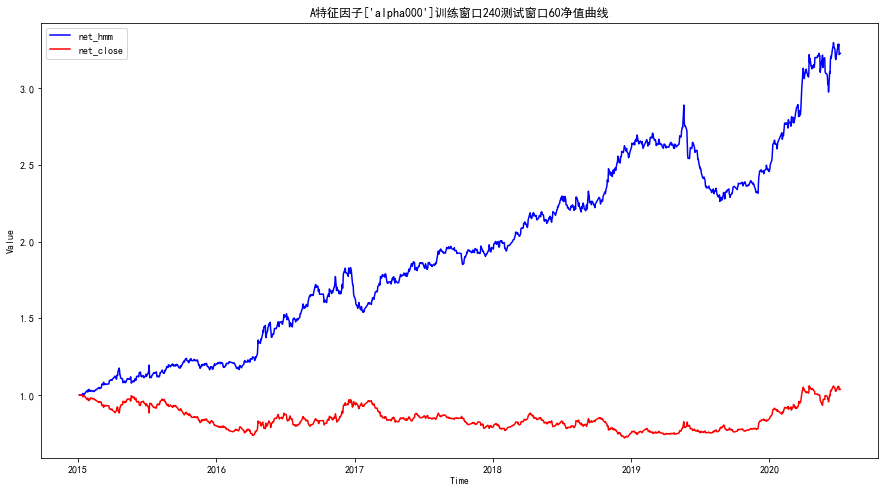

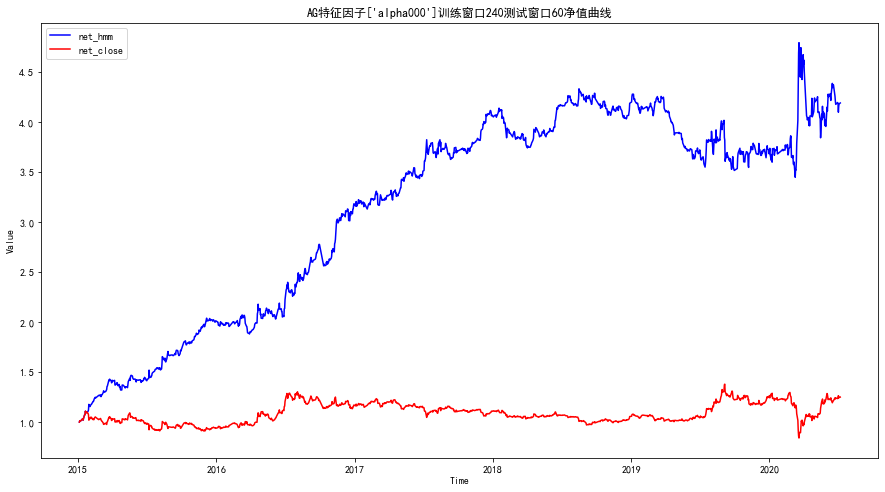

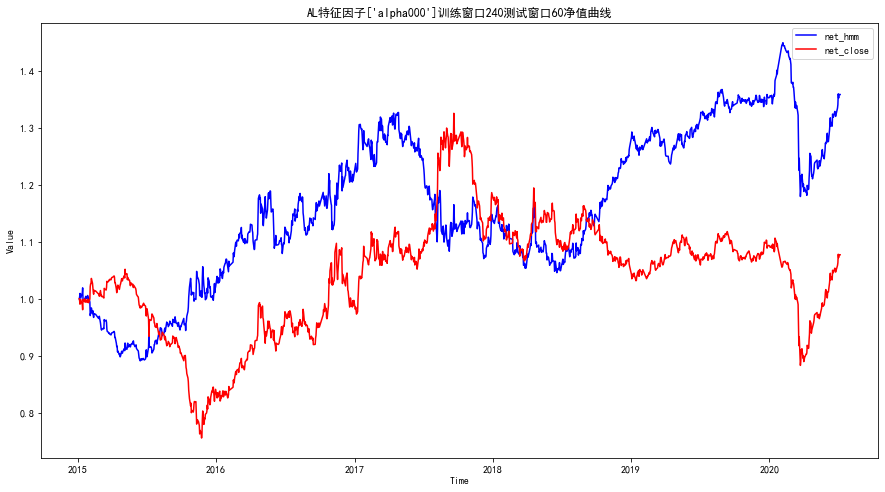

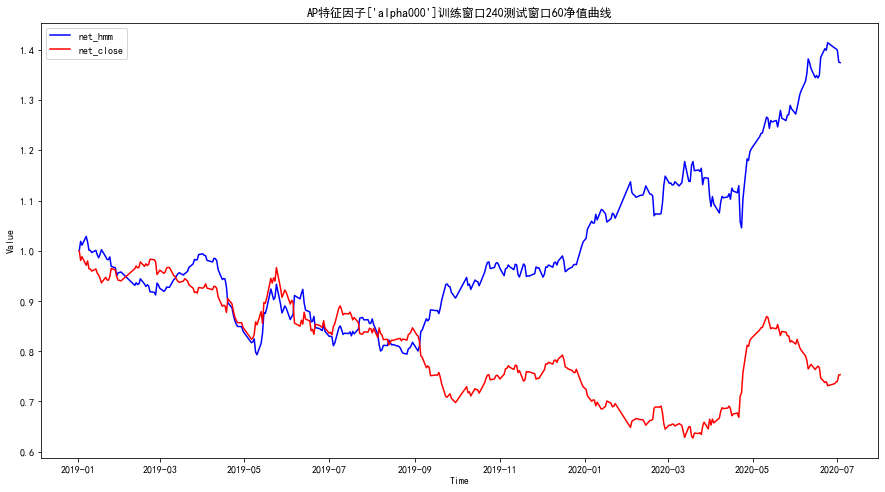

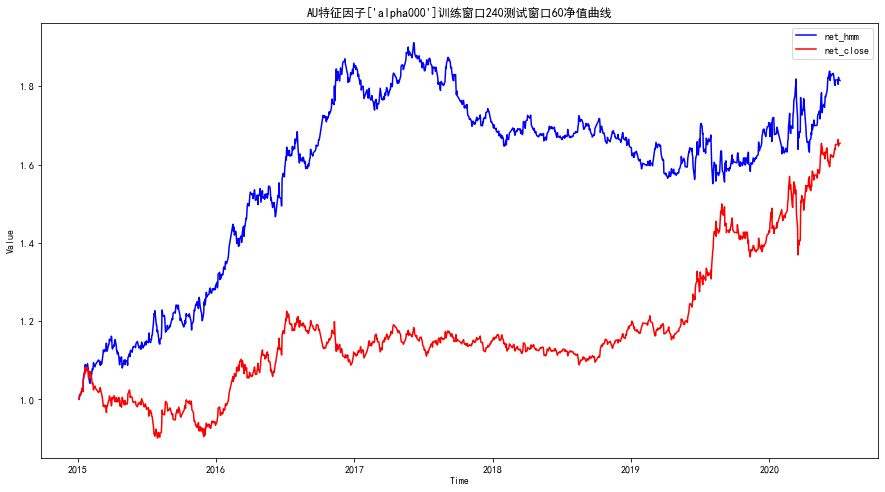

...

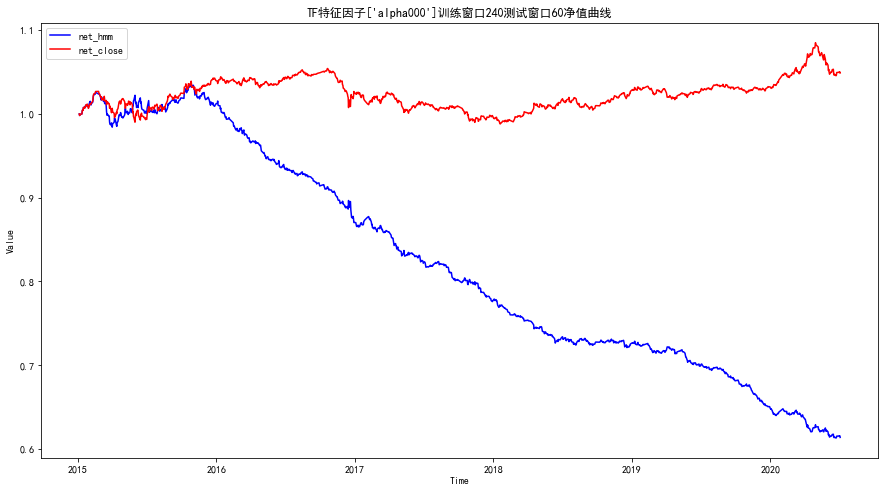

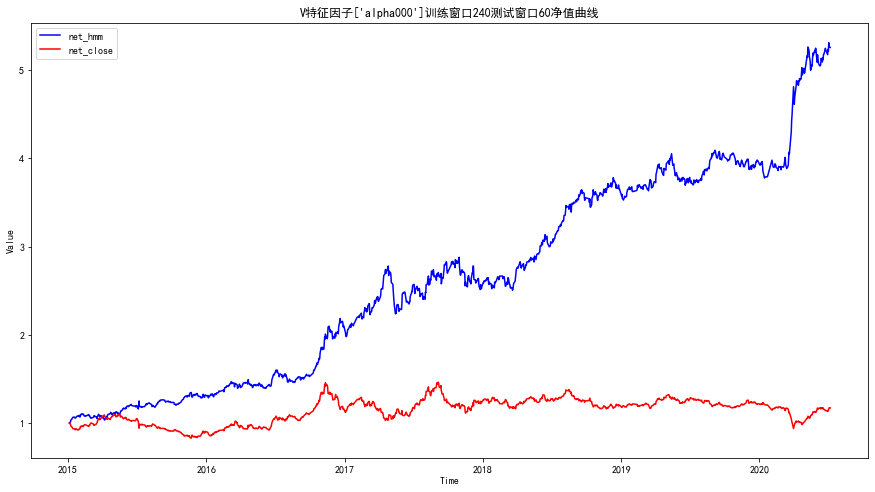

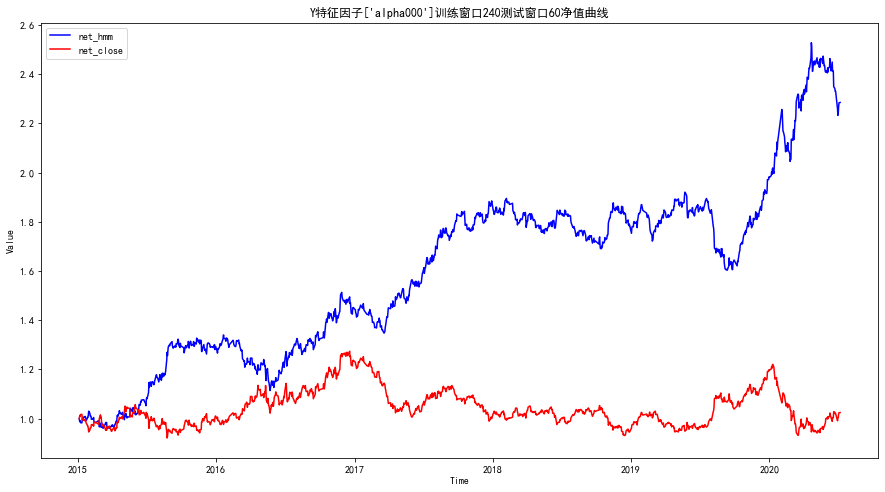

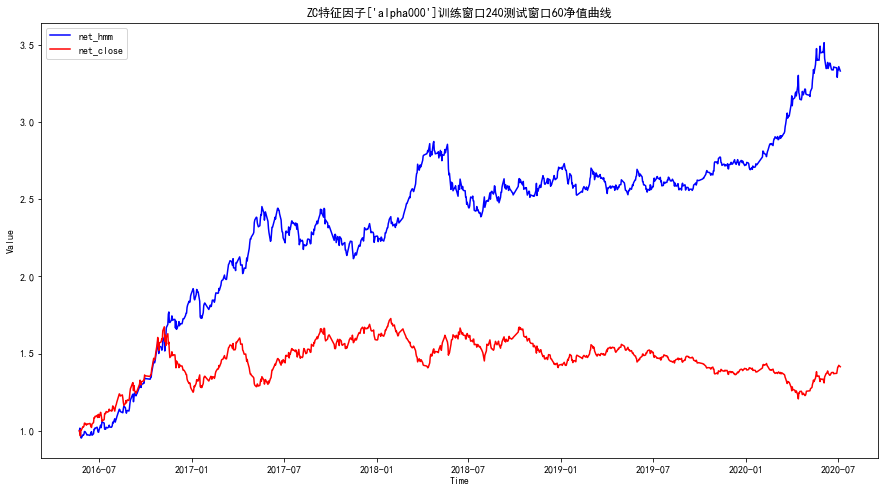

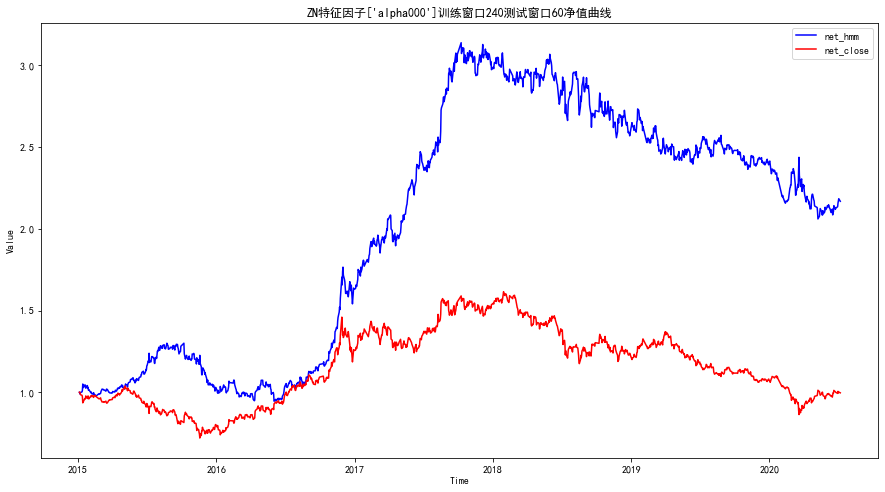

In [27]:
s_date = '2015-01-01'
train_s_date = '2014-01-01'

all_feature_lst = PowerSetsRecursive(factor_lst)
all_feature_lst = [i for i in all_feature_lst if len(i)>=1]
# all_feature_lst = [['price_deviation']]
train_days_lst = [240]
test_days_lst = [60]
period_param_state = []    
asset_lst = ['A', 'AG', 'AL', 'AP', 'AU', 'B', 'BU', 'C', 'CF', 'CS', 'CU', 'FG',
               'HC', 'I', 'IC', 'IF', 'IH', 'J', 'JD', 'JM', 'L', 'M', 'MA', 'NI', 'OI', 'P',
               'PB', 'PP', 'RB', 'RM', 'RU', 'SC', 'SF', 'SM', 'SN', 'SR',
               'T', 'TA', 'TF', 'V', 'Y', 'ZC', 'ZN']
# asset_lst = ['IF']
for feature_lst in all_feature_lst:
    for train_days in train_days_lst:
        for test_days in test_days_lst:
            for asset in asset_lst:
                try:
                    dataFactory = DataFactory(asset, factor_lst, future_period, s_data_date, e_data_date)
                    dataset = dataFactory.get_dataset()
                    data_set = dataset[dataset.index >= train_s_date]
                    print(asset, '特征因子：', feature_lst, '训练窗口:', train_days, '测试窗口:', test_days)
                    strategy_obj = HmmStrategy(asset=asset, s_date=s_date, max_states=max_states, leverage=1, fee=0.001, data_set=data_set, 
                                               cols_features=feature_lst, train_days=train_days, test_days=test_days, insample=False)
                    annR, sharp, max_retrace, ret_df = strategy_obj.run_outsample()
                    print('年化收益: ' + str(annR))
                    print('夏普比率: ' + str(sharp))
                    print('最大回撤: ' + str(max_retrace))
                    period_param_state.append([asset, feature_lst, train_days, test_days, annR, sharp, max_retrace])
                except:
                    continue
period_param_state_df = pd.DataFrame(
    period_param_state, columns=['instrument', '特征因子', '训练窗口', '测试窗口', '年化收益', '夏普比率', '最大回撤'])
    

In [28]:
period_param_state_df.to_csv('c:/e/hmm/resualt/future_sharp_20150101_20200701_close.csv', encoding='gbk')

## 样本外不同品种回测按不同周期统计

A 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.10097185944512255
夏普比率: 0.6688921231408909
最大回撤: 0.19353519821938092
AG 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.46094239563004336
夏普比率: 1.7744108175514488
最大回撤: 0.19895543798919024
AL 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.09565062576822791
夏普比率: 0.7245318086897914
最大回撤: 0.1725514841943071
AP 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.2466368592450081
夏普比率: 0.9375356829701023
最大回撤: 0.22920808860010156
AU 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.19362904326452557
夏普比率: 1.1643521054820603
最大回撤: 0.22765991296805954
B 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.02144972802541467
夏普比率: 0.04507477282754534
最大回撤: 0.7604854386742657
BU 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.3362643624064521
夏普比率: 0.9805394695988315
最大回撤: 0.30299234762128013
C 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: -0.007018706609188352
夏普比率: -0.06623802198283994
最大回撤: 0.41209998130132364
CF 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 60
年化收益: 0.116668508

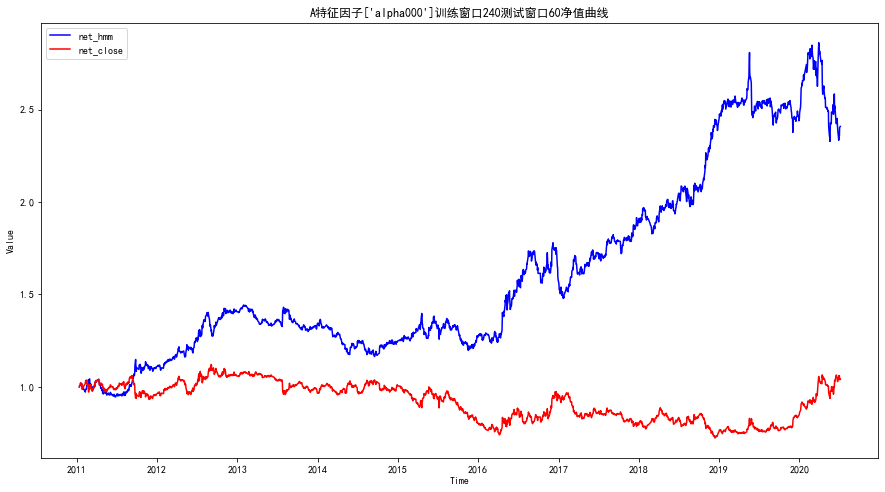

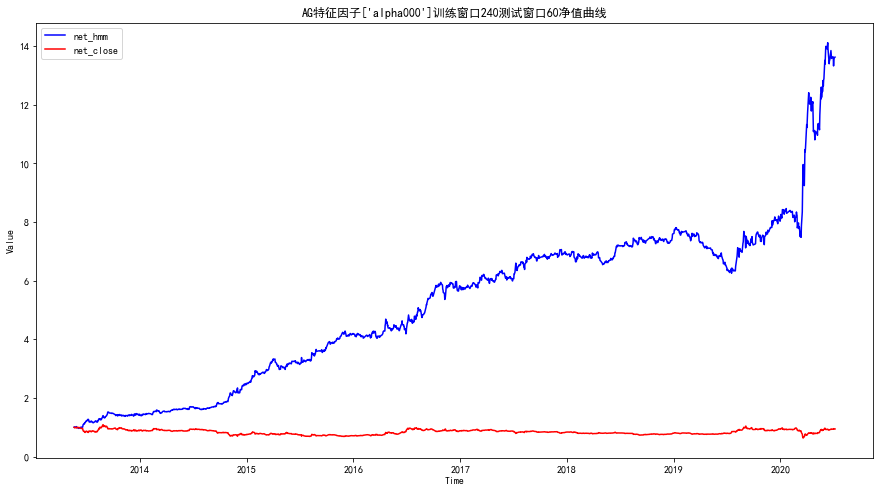

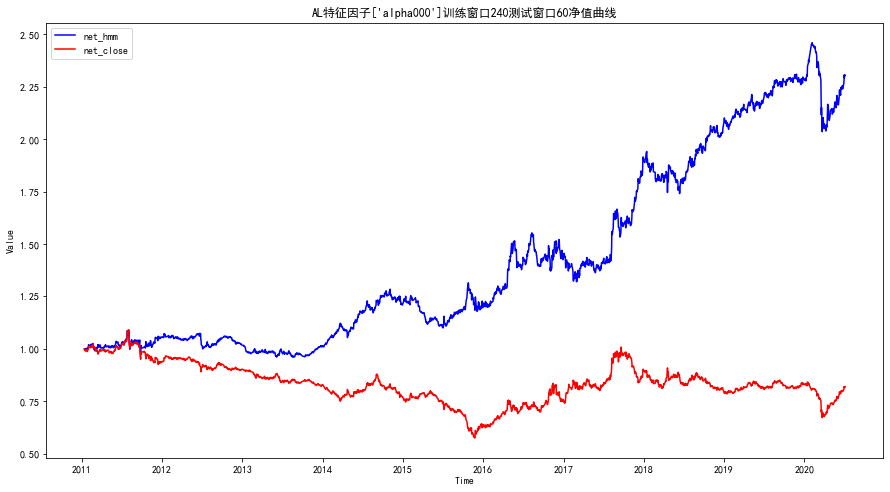

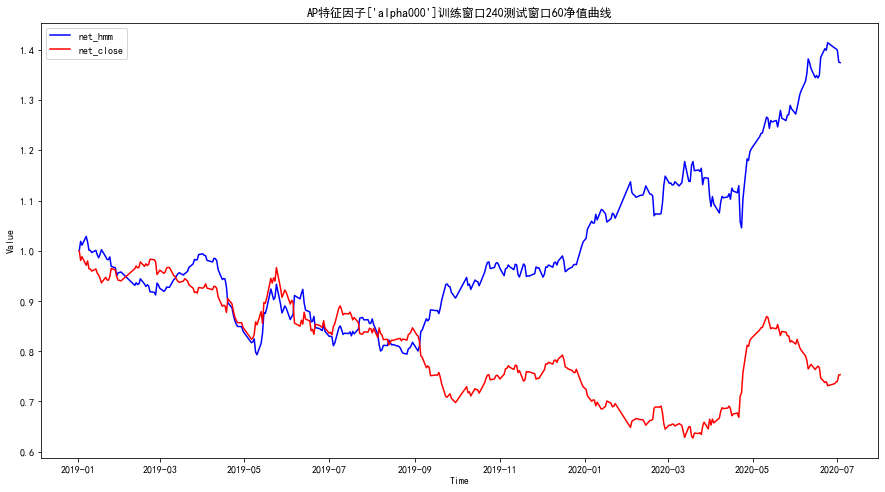

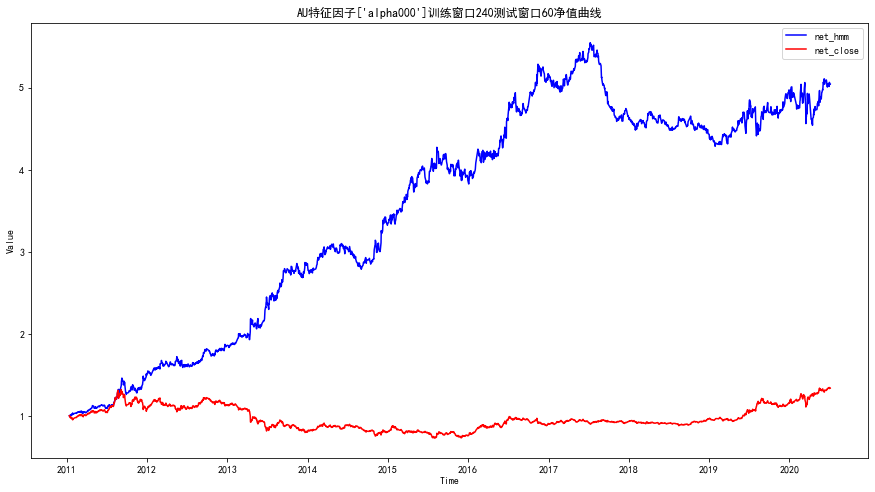

...

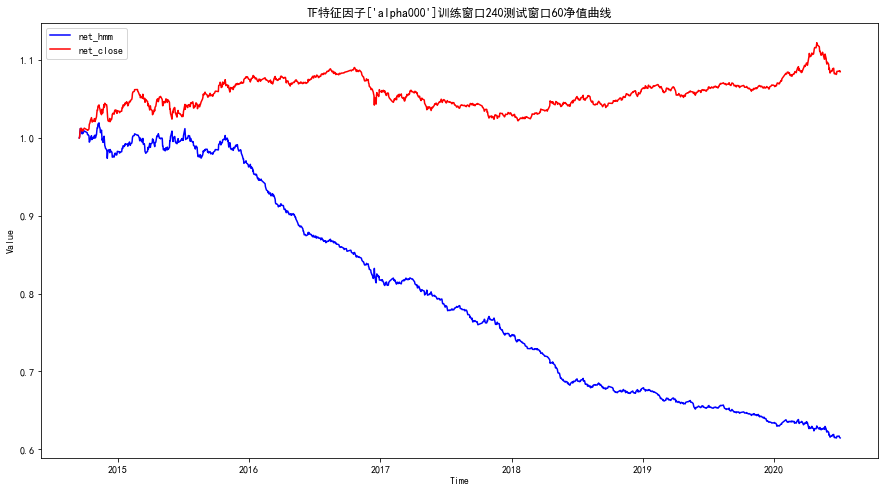

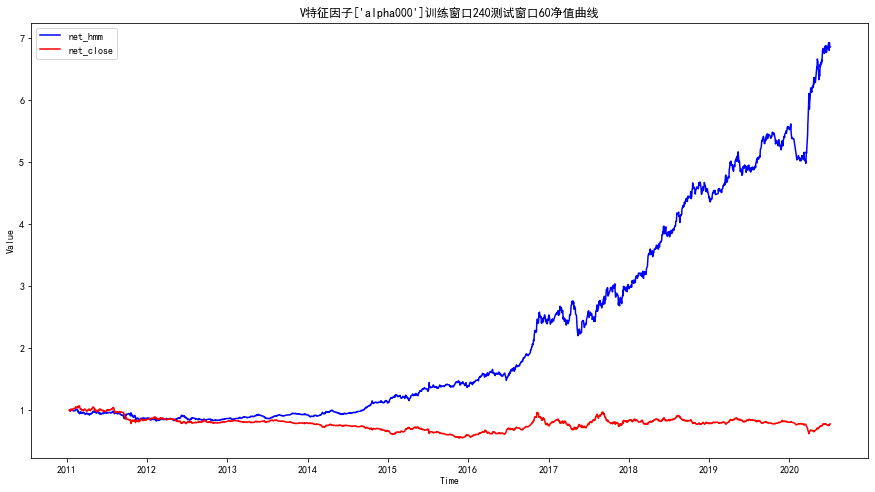

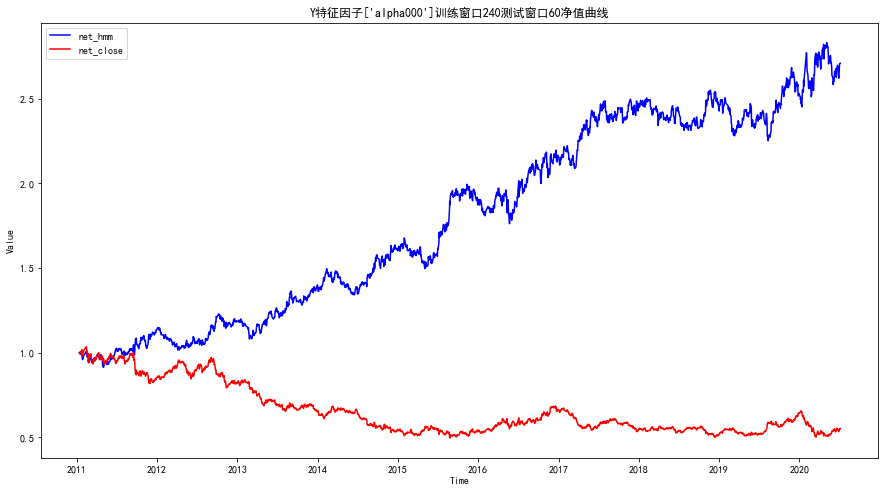

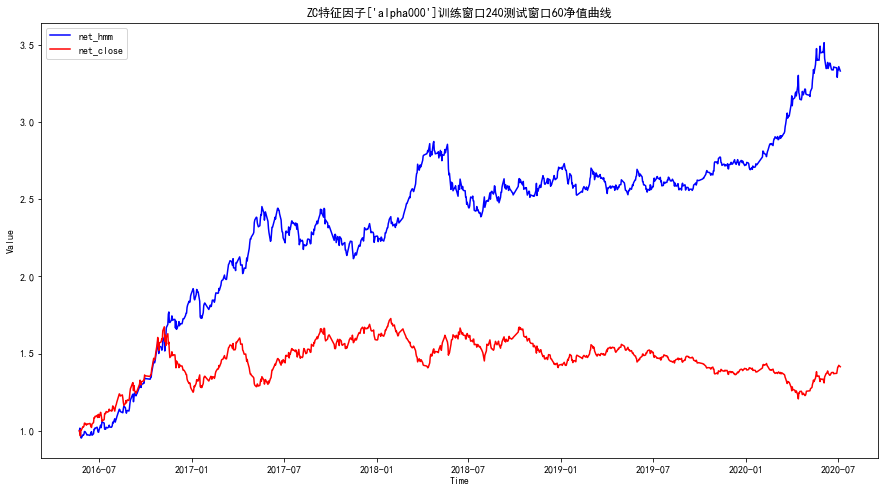

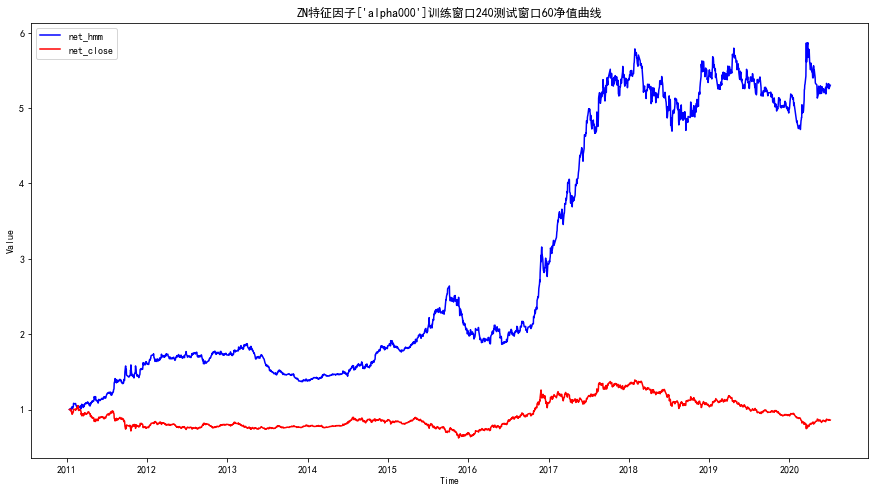

In [29]:
s_date = '2011-01-01'
train_s_date = '2010-01-01'
date_lst = [('2011-01-01', '2012-01-01'), ('2012-01-01', '2013-01-01'), ('2013-01-01', '2014-01-01'), ('2014-01-01', '2015-01-01'), 
           ('2015-01-01', '2016-01-01'), ('2016-01-01', '2017-01-01'), ('2017-01-01', '2018-01-01'), ('2018-01-01', '2019-01-01'), 
           ('2019-01-01', '2020-01-01'), ]

all_feature_lst = PowerSetsRecursive(factor_lst)
all_feature_lst = [i for i in all_feature_lst if len(i)>=1]
# all_feature_lst = [['price_deviation']]
train_days_lst = [240]
test_days_lst = [60]
period_param_state = []    
asset_lst = ['A', 'AG', 'AL', 'AP', 'AU', 'B', 'BU', 'C', 'CF', 'CS', 'CU', 'FG',
               'HC', 'I', 'IC', 'IF', 'IH', 'J', 'JD', 'JM', 'L', 'M', 'MA', 'NI', 'OI', 'P',
               'PB', 'PP', 'RB', 'RM', 'RU', 'SC', 'SF', 'SM', 'SN', 'SR',
               'T', 'TA', 'TF', 'V', 'Y', 'ZC', 'ZN']
for feature_lst in all_feature_lst:
    for train_days in train_days_lst:
        for test_days in test_days_lst:
            for asset in asset_lst:
                try:
                    dataFactory = DataFactory(asset, factor_lst, future_period, s_data_date, e_data_date)
                    dataset = dataFactory.get_dataset()
                    data_set = dataset[dataset.index >= train_s_date]
                    print(asset, '特征因子：', feature_lst, '训练窗口:', train_days, '测试窗口:', test_days)
                    strategy_obj = HmmStrategy(asset=asset, s_date=s_date, max_states=max_states, leverage=1, fee=0.001, data_set=data_set, 
                                               cols_features=feature_lst, train_days=train_days, test_days=test_days, insample=False)
                    annR, sharp, max_retrace, ret_df = strategy_obj.run_outsample()
                    print('年化收益: ' + str(annR))
                    print('夏普比率: ' + str(sharp))
                    print('最大回撤: ' + str(max_retrace))
                    for (sdate, edate) in date_lst:
                        net = ret_df.loc[sdate:edate, :]
                        if len(net) > 10:
                            net_lst = net['net'].tolist()
                            annR = annROR(net_lst, 1)
                            sharp = yearsharpRatio(net_lst, 1)
                            max_retrace = maxRetrace(net_lst, 1)
                            period_param_state.append([asset, sdate, edate, feature_lst, train_days, test_days, annR, sharp, max_retrace])
                except:
                    continue
period_param_state_df = pd.DataFrame(
    period_param_state, columns=['instrument', 'sdate', 'edate', '特征因子', '训练窗口', '测试窗口', '年化收益', '夏普比率', '最大回撤'])

In [30]:
period_param_state_df.to_csv('c:/e/hmm/resualt/future_ann_sharp_10_20.csv', encoding='gbk')

In [31]:
ann_winR = []
for code, group in period_param_state_df.groupby(['instrument']):
    win_r = len(group[group['夏普比率'] > 0]) / len(group)
    win_r_20 = len(group[group['夏普比率'] > 0.2]) / len(group)
    ann_winR.append([code, win_r, win_r_20])
ann_winR_df = pd.DataFrame(ann_winR, columns=['品种', '年胜率', '年夏普超过0.2胜率'])
ann_winR_df.to_csv('c:/e/hmm/resualt/future_ann_sharp_winR_close.csv', encoding='gbk')

In [32]:
ann_winR_df

,品种,年胜率,年夏普超过0.2胜率
0,A,0.666667,0.555556
1,AG,1.000000,1.000000
2,AL,0.666667,0.666667
3,AP,1.000000,0.000000
4,AU,0.777778,0.777778
5,B,0.777778,0.666667
6,BU,0.666667,0.666667
7,C,0.333333,0.333333
8,CF,0.777778,0.555556
9,CS,0.500000,0.500000


IC 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 30
年化收益: 0.3285460796616555
夏普比率: 1.18745650774941
最大回撤: 0.14498591461119148
IF 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 30
年化收益: 0.28363149646642816
夏普比率: 0.9677223596671033
最大回撤: 0.5574189613571012
IH 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 30
年化收益: 0.19725782815778237
夏普比率: 0.8999124033636678
最大回撤: 0.25734857564425073


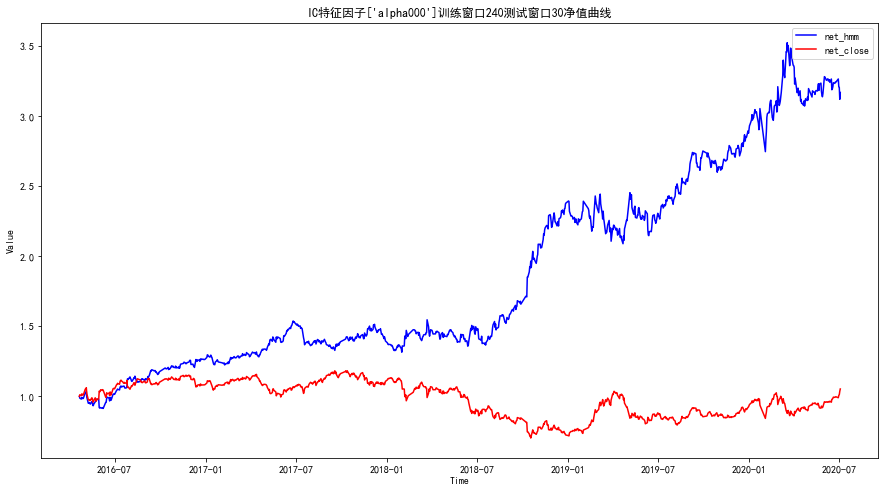

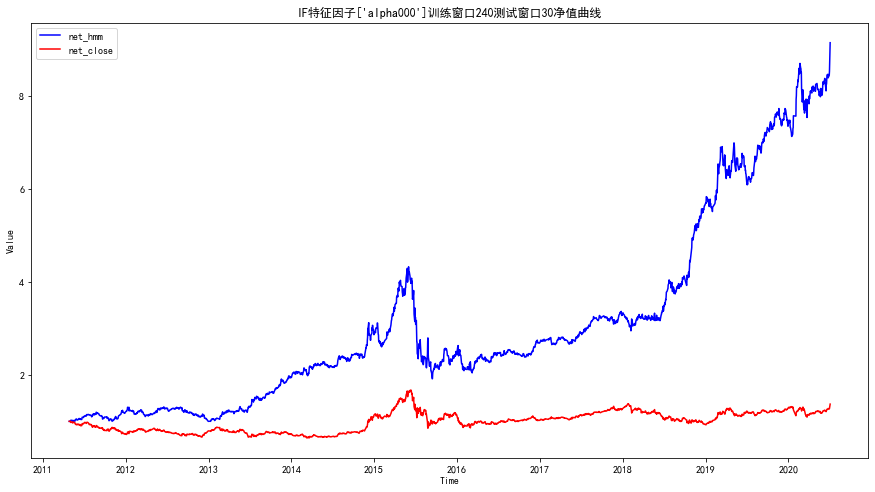

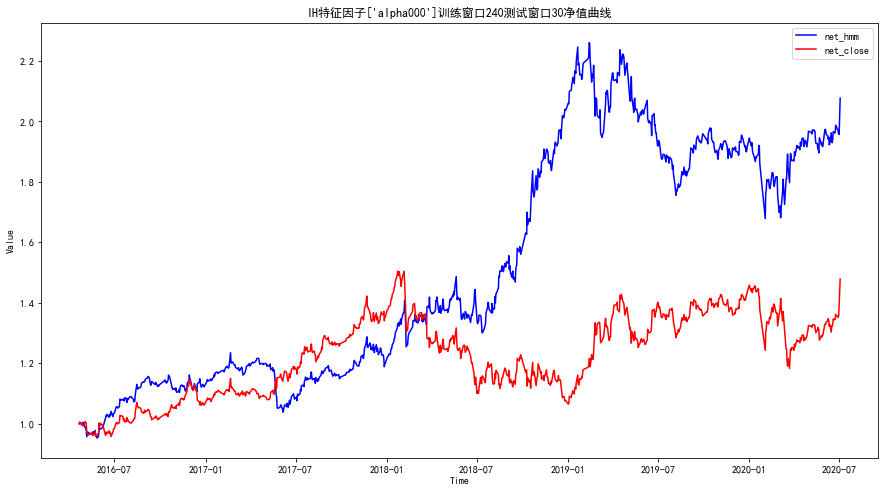

In [36]:
# 三大股指
s_date = '2011-01-01'
train_s_date = '2010-01-01'
date_lst = [('2011-01-01', '2012-01-01'), ('2012-01-01', '2013-01-01'), ('2013-01-01', '2014-01-01'), ('2014-01-01', '2015-01-01'), 
           ('2015-01-01', '2016-01-01'), ('2016-01-01', '2017-01-01'), ('2017-01-01', '2018-01-01'), ('2018-01-01', '2019-01-01'), 
           ('2019-01-01', '2020-01-01'), ]

all_feature_lst = PowerSetsRecursive(factor_lst)
all_feature_lst = [i for i in all_feature_lst if len(i)>=1]
# all_feature_lst = [['price_deviation']]
train_days_lst = [240]
test_days_lst = [30]
period_param_state = []    
asset_lst = ['IC', 'IF', 'IH']
for feature_lst in all_feature_lst:
    for train_days in train_days_lst:
        for test_days in test_days_lst:
            for asset in asset_lst:
                try:
                    dataFactory = DataFactory(asset, factor_lst, future_period, s_data_date, e_data_date)
                    dataset = dataFactory.get_dataset()
                    data_set = dataset[dataset.index >= train_s_date]
                    print(asset, '特征因子：', feature_lst, '训练窗口:', train_days, '测试窗口:', test_days)
                    strategy_obj = HmmStrategy(asset=asset, s_date=s_date, max_states=max_states, leverage=1, fee=0.001, data_set=data_set, 
                                               cols_features=feature_lst, train_days=train_days, test_days=test_days, insample=False)
                    annR, sharp, max_retrace, ret_df = strategy_obj.run_outsample()
                    print('年化收益: ' + str(annR))
                    print('夏普比率: ' + str(sharp))
                    print('最大回撤: ' + str(max_retrace))
                    for (sdate, edate) in date_lst:
                        net = ret_df.loc[sdate:edate, :]
                        if len(net) > 10:
                            net_lst = net['net'].tolist()
                            annR = annROR(net_lst, 1)
                            sharp = yearsharpRatio(net_lst, 1)
                            max_retrace = maxRetrace(net_lst, 1)
                            period_param_state.append([asset, sdate, edate, feature_lst, train_days, test_days, annR, sharp, max_retrace])
                except:
                    continue
period_param_state_df = pd.DataFrame(
    period_param_state, columns=['instrument', 'sdate', 'edate', '特征因子', '训练窗口', '测试窗口', '年化收益', '夏普比率', '最大回撤'])

## 特征因子样本外回测

### 样本外不同滚动窗口回测，参数敏感性测试

IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 30
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 60
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 90
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 120
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 150
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 180
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 210
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 240
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 270
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 300
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 330
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 360
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 390
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 420
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 450
IF 特征因子： ['alpha000'] 训练窗口: 480 测试窗口: 480
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 30
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 60
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 90
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 120
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 150
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 180
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 210
IF 特征因子： ['alpha000'] 训练窗口: 450 测试窗口: 24

IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 150
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 180
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 210
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 240
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 270
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 300
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 330
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 360
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 390
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 420
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 450
IF 特征因子： ['alpha000'] 训练窗口: 120 测试窗口: 480
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 30
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 60
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 90
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 120
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 150
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 180
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 210
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 240
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 270
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 300
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 330
IF 特征因子： ['alpha000'] 训练窗口: 90 测试窗口: 360
IF 特征因子

IH 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 300
IH 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 330
IH 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 360
IH 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 390
IH 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 420
IH 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 450
IH 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 480
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 30
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 60
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 90
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 120
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 150
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 180
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 210
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 240
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 270
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 300
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 330
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 360
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 390
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 420
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 450
IH 特征因子： ['alpha000'] 训练窗口: 150 测试窗口: 480
IH 特征因子： ['alpha000'] 训练窗口: 120 测试窗口:

IC 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 450
IC 特征因子： ['alpha000'] 训练窗口: 240 测试窗口: 480
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 30
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 60
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 90
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 120
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 150
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 180
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 210
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 240
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 270
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 300
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 330
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 360
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 390
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 420
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 450
IC 特征因子： ['alpha000'] 训练窗口: 210 测试窗口: 480
IC 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 30
IC 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 60
IC 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 90
IC 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 120
IC 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 150
IC 特征因子： ['alpha000'] 训练窗口: 180 测试窗口: 18

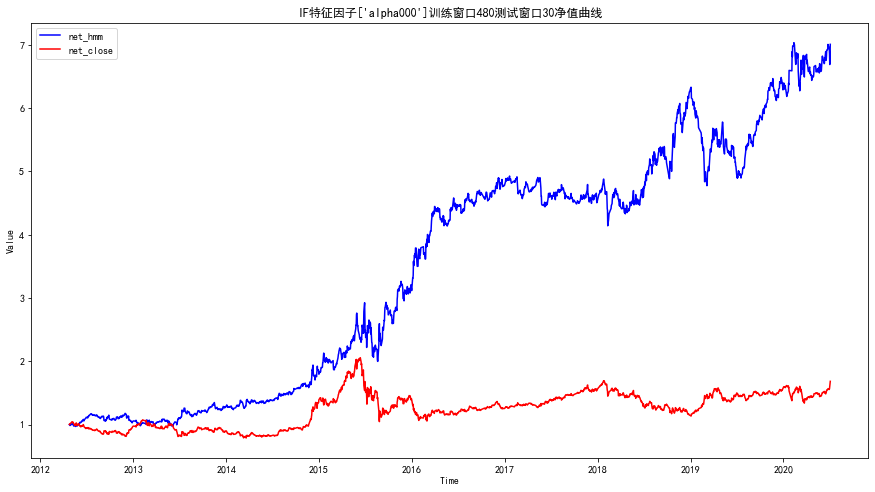

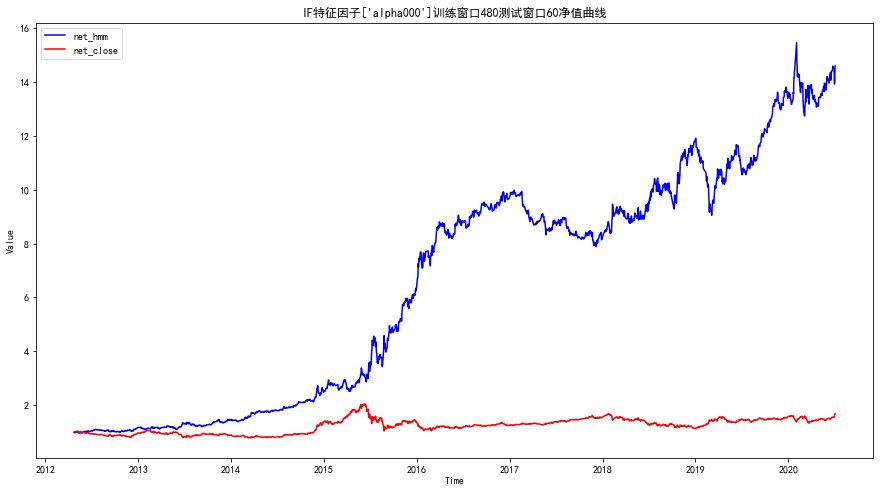

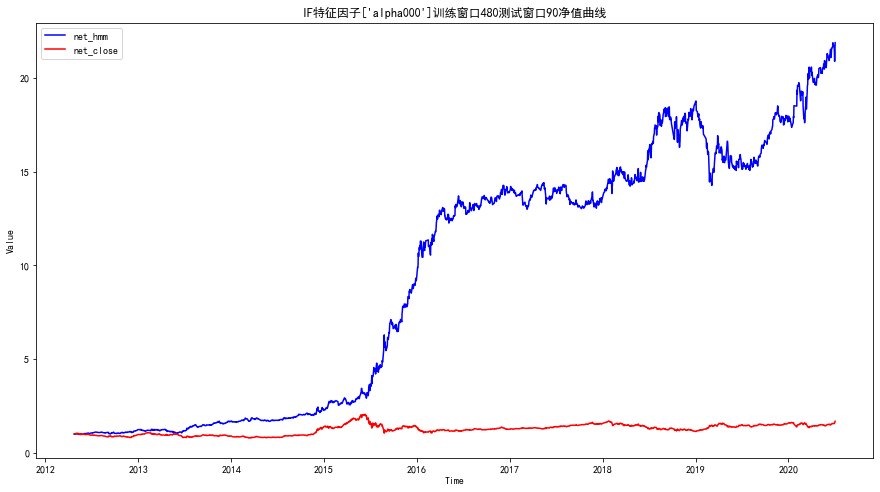

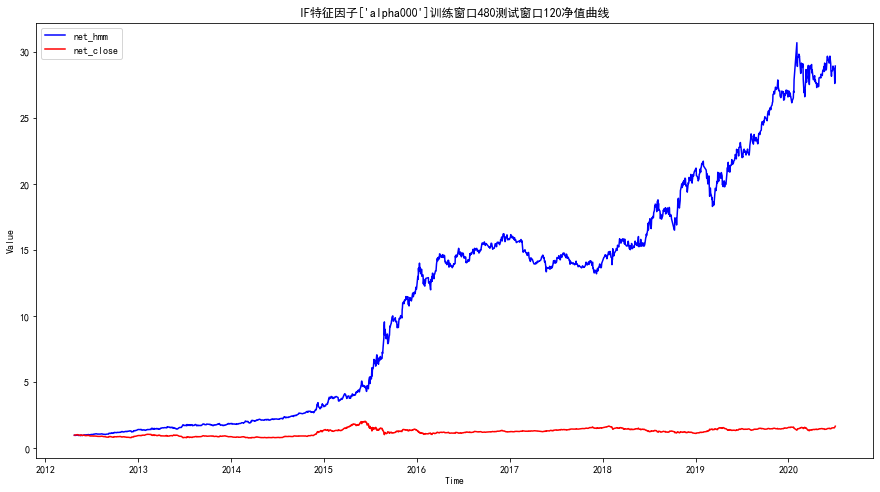

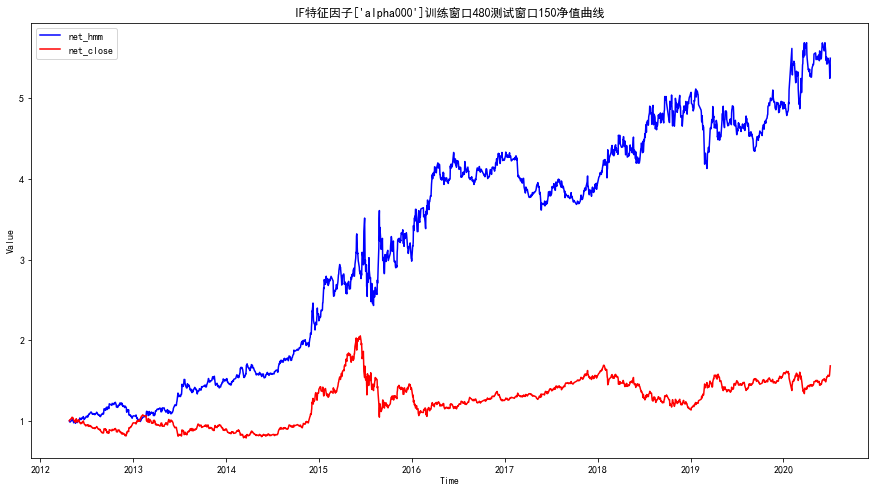

...

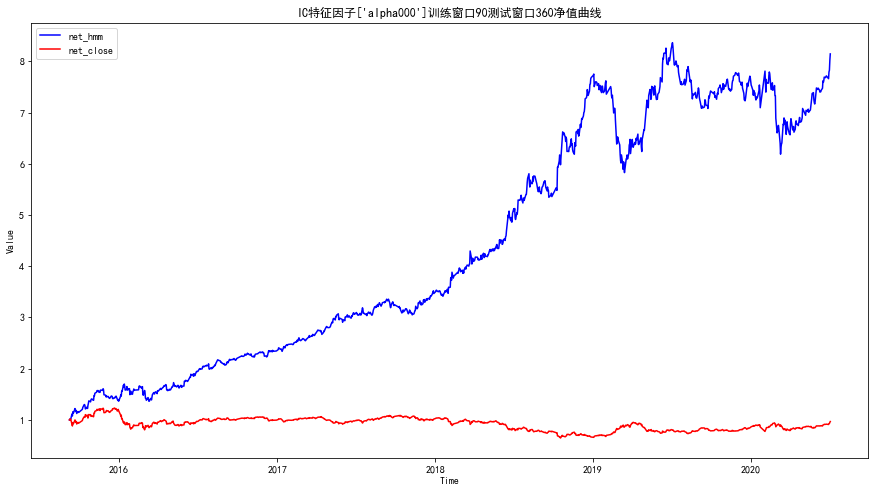

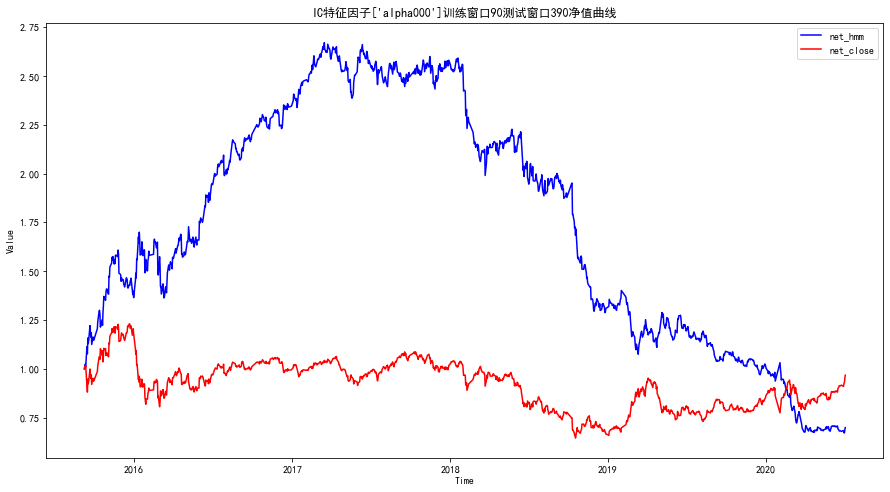

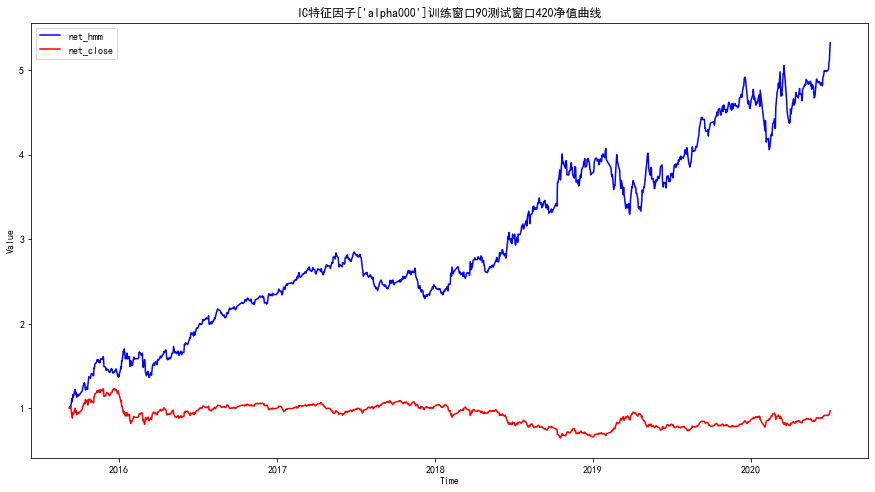

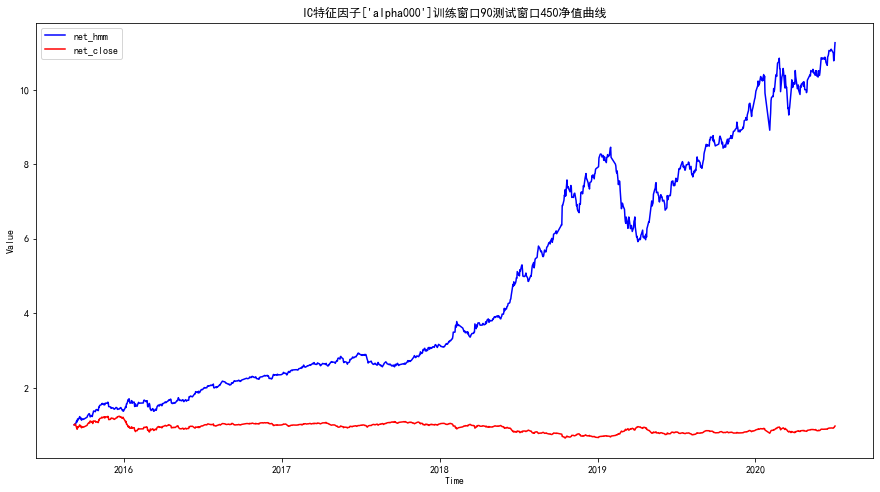

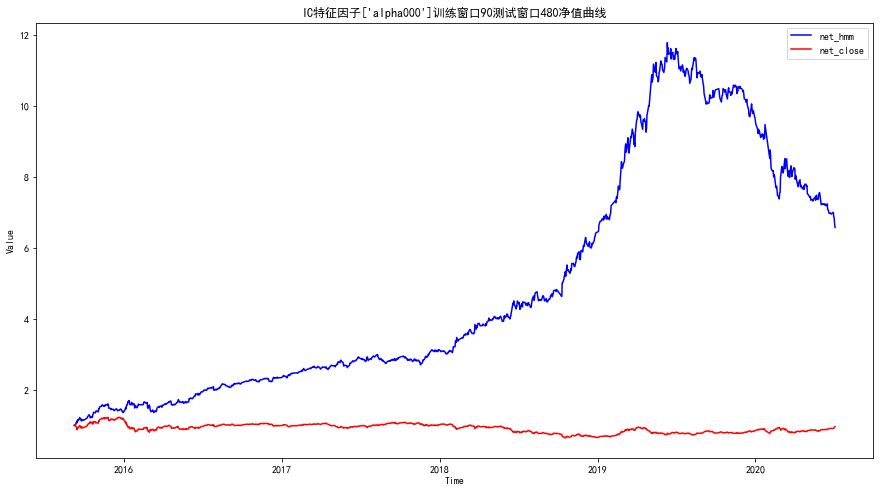

In [7]:
s_date = '2012-01-01'
train_s_date = '2010-01-01'
date_lst = [('2012-01-01', '2013-01-01'), ('2013-01-01', '2014-01-01'), ('2014-01-01', '2015-01-01'), 
           ('2015-01-01', '2016-01-01'), ('2016-01-01', '2017-01-01'), ('2017-01-01', '2018-01-01'), ('2018-01-01', '2019-01-01'), 
           ('2019-01-01', '2020-01-01'), ]

all_feature_lst = PowerSetsRecursive(factor_lst)
all_feature_lst = [i for i in all_feature_lst if len(i)>=1]
# all_feature_lst = [['price_deviation']]
train_days_lst = [i for i in range(480, 80, -30)]
test_days_lst = [i for i in range(30, 500, 30)]
period_param_state = []    
asset_lst = ['A', 'AG', 'AL', 'AP', 'AU', 'B', 'BU', 'C', 'CF', 'CS', 'CU', 'FG',
               'HC', 'I', 'IC', 'IF', 'IH', 'J', 'JD', 'JM', 'L', 'M', 'MA', 'NI', 'OI', 'P',
               'PB', 'PP', 'RB', 'RM', 'RU', 'SC', 'SF', 'SM', 'SN', 'SR',
               'T', 'TA', 'TF', 'V', 'Y', 'ZC', 'ZN']
asset_lst = ['IF', 'IH', 'IC']
for asset in asset_lst:
    for feature_lst in all_feature_lst:
        for train_days in train_days_lst:
            for test_days in test_days_lst:
                try:
                    dataFactory = DataFactory(asset, factor_lst, future_period, s_data_date, e_data_date)
                    dataset = dataFactory.get_dataset()
                    data_set = dataset[dataset.index >= train_s_date]
                    print(asset, '特征因子：', feature_lst, '训练窗口:', train_days, '测试窗口:', test_days)
                    strategy_obj = HmmStrategy(asset=asset, s_date=s_date, max_states=max_states, leverage=1, fee=0.001, data_set=data_set, 
                                               cols_features=feature_lst, train_days=train_days, test_days=test_days, insample=False)
                    annR, sharp, max_retrace, ret_df = strategy_obj.run_outsample()
                    for (sdate, edate) in date_lst:
                        net = ret_df.loc[sdate:edate, :]
                        if len(net) > 10:
                            net_lst = net['net'].tolist()
                            annR = annROR(net_lst, 1)
                            sharp = yearsharpRatio(net_lst, 1)
                            max_retrace = maxRetrace(net_lst, 1)
                            period_param_state.append([asset, sdate, edate, feature_lst, train_days, test_days, annR, sharp, max_retrace])
                except:
                    continue
period_param_state_df = pd.DataFrame(
    period_param_state, columns=['instrument', 'sdate', 'edate', '特征因子', '训练窗口', '测试窗口', '年化收益', '夏普比率', '最大回撤'])



In [8]:
period_param_state_df

,instrument,sdate,edate,特征因子,训练窗口,测试窗口,年化收益,夏普比率,最大回撤
0,IF,2012-01-01,2013-01-01,[alpha000],480,30,0.083469,0.398743,0.126814
1,IF,2013-01-01,2014-01-01,[alpha000],480,30,0.236383,0.910036,0.108113
2,IF,2014-01-01,2015-01-01,[alpha000],480,30,0.398032,1.516630,0.121638
3,IF,2015-01-01,2016-01-01,[alpha000],480,30,0.725797,1.134812,0.316986
4,IF,2016-01-01,2017-01-01,[alpha000],480,30,0.458651,1.737696,0.076752
...,...,...,...,...,...,...,...,...,...
3579,IC,2015-01-01,2016-01-01,[alpha000],90,480,1.731956,2.314696,0.151571
3580,IC,2016-01-01,2017-01-01,[alpha000],90,480,0.641814,1.597711,0.198128
3581,IC,2017-01-01,2018-01-01,[alpha000],90,480,0.334650,1.755416,0.094175
3582,IC,2018-01-01,2019-01-01,[alpha000],90,480,1.123399,2.892870,0.059854


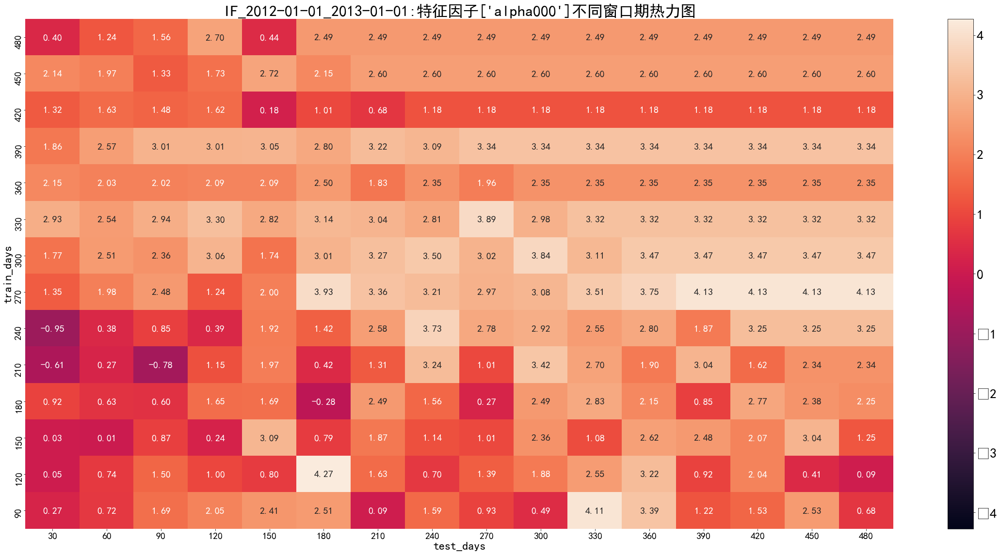

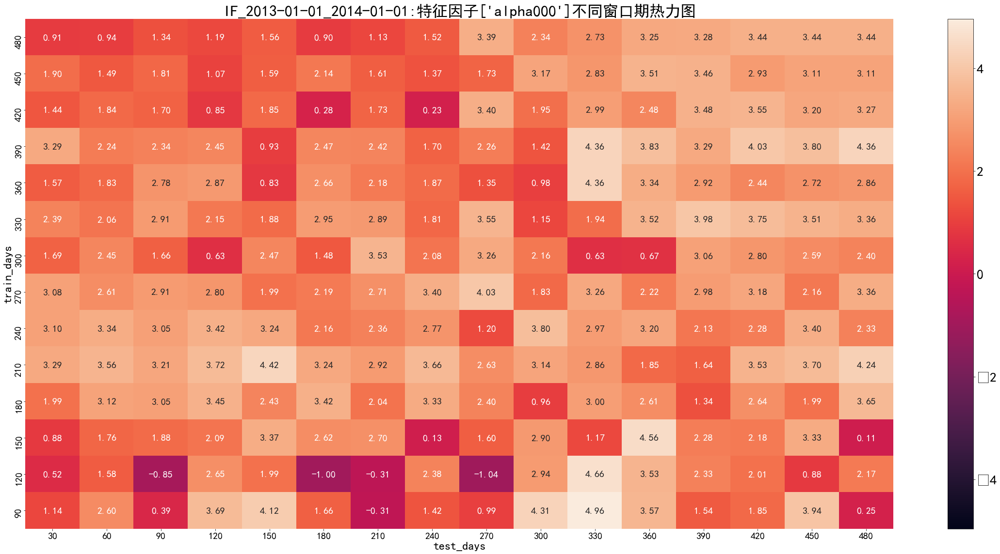

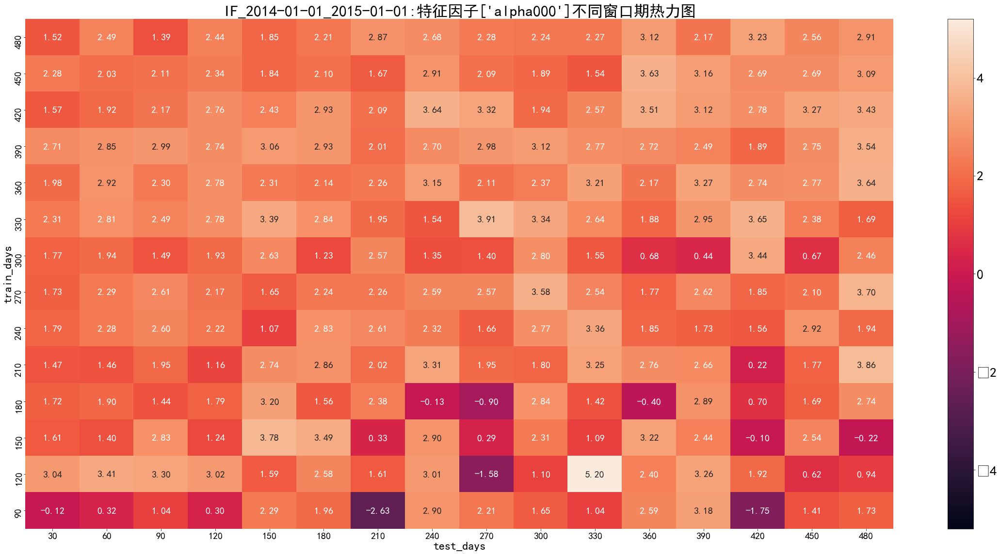

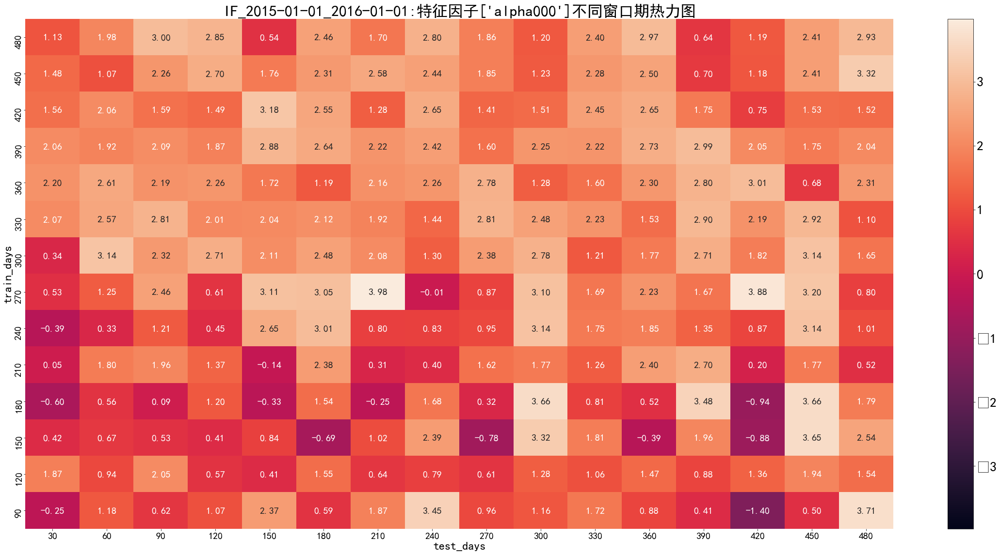

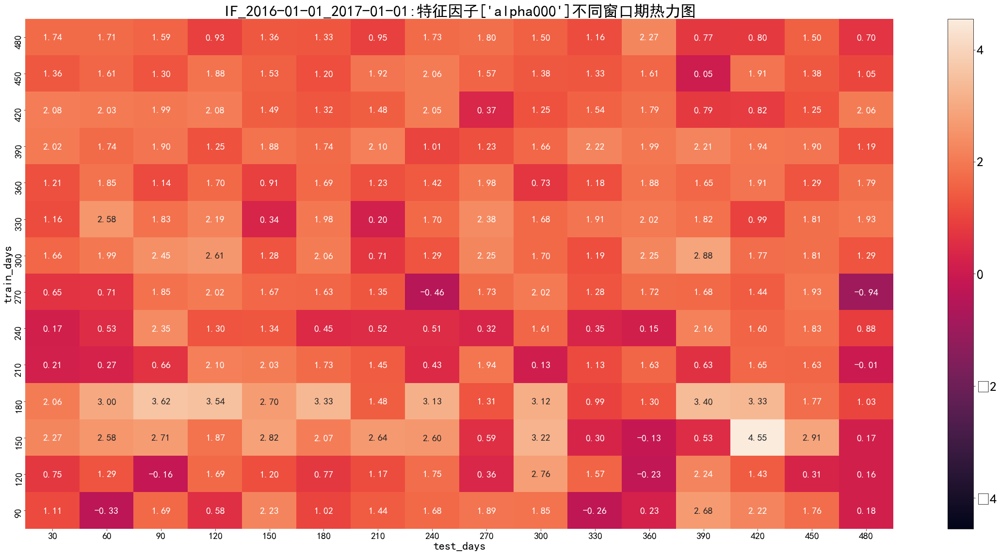

...

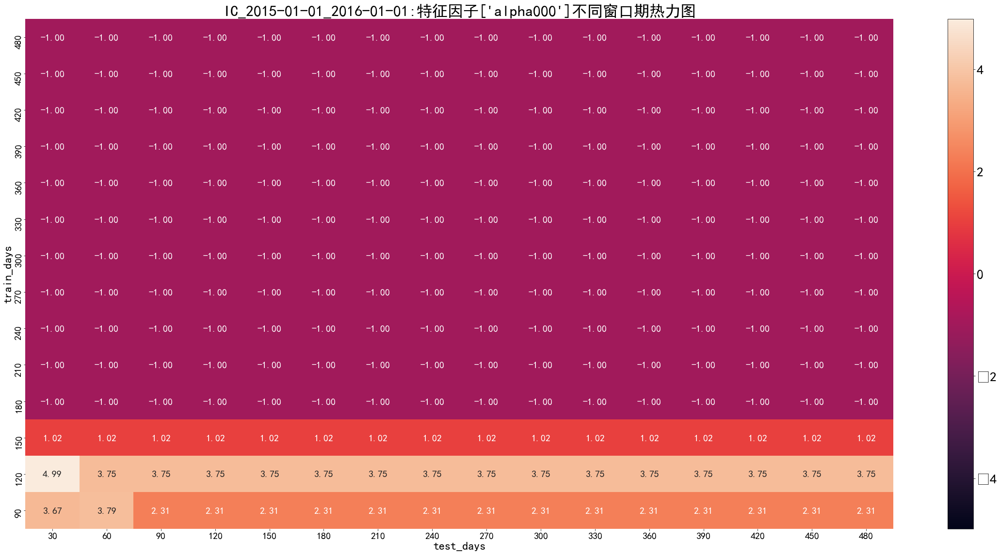

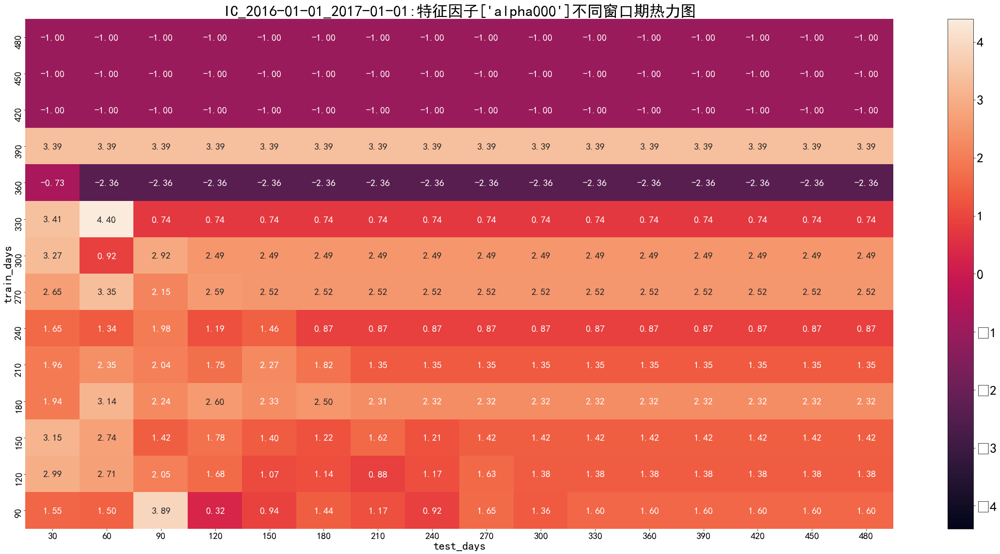

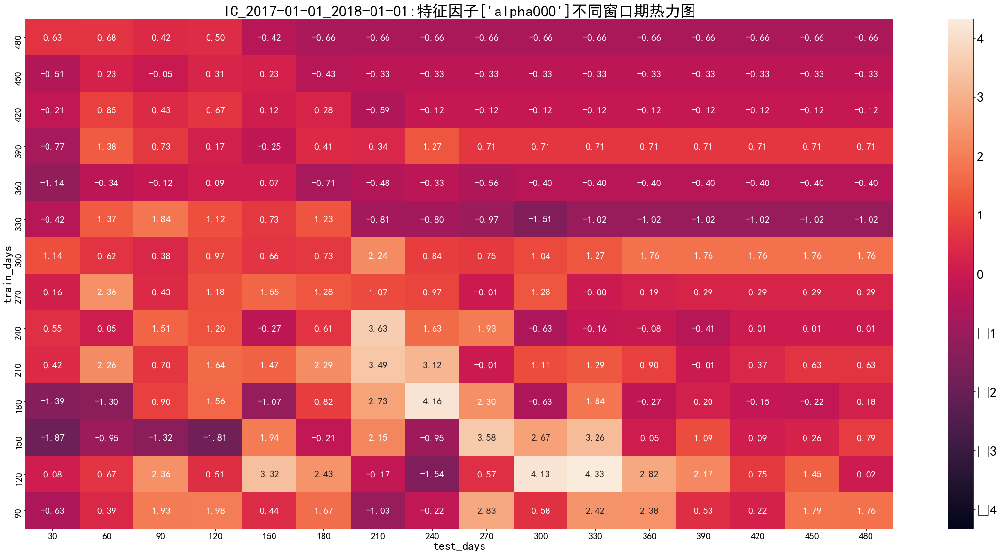

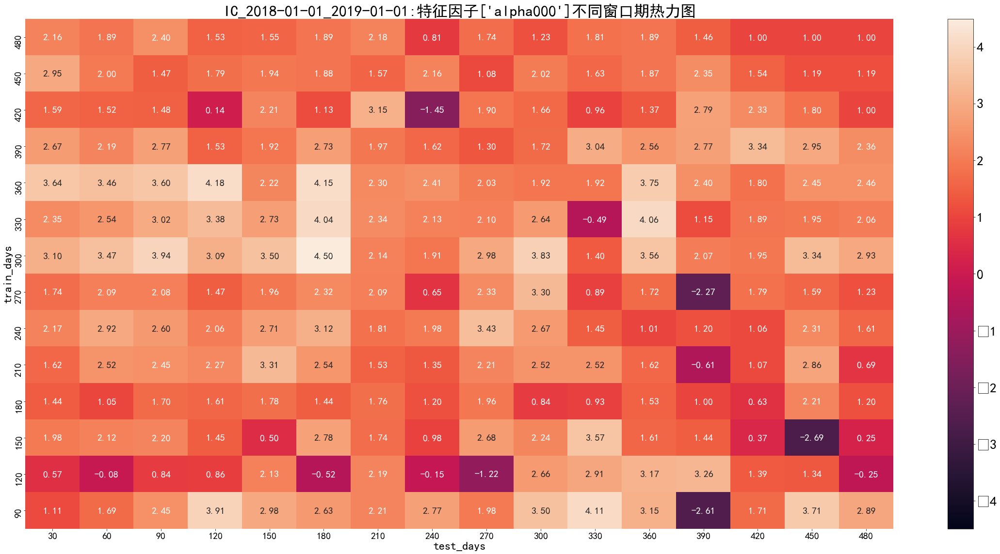

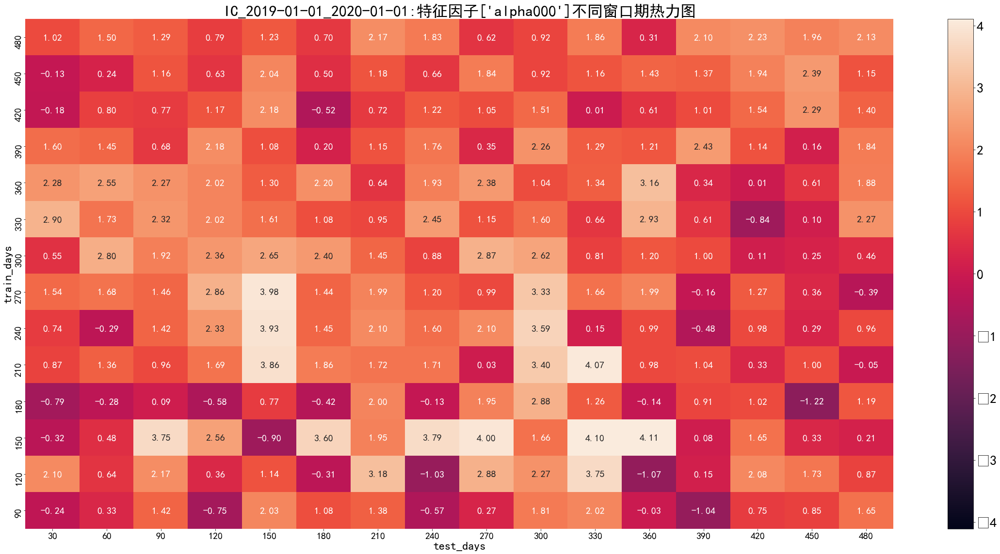

In [14]:
for feature_lst in all_feature_lst:
    for asset in asset_lst:
        for (sdate, edate) in date_lst:
            group_ = period_param_state_df[
                (period_param_state_df['sdate'] == sdate) & (period_param_state_df['edate'] == edate) & (period_param_state_df['instrument'] == asset)]
            
            if len(group_) == 0:
                continue
            harvest = []
            for train_days in train_days_lst:
                _group = group_[(group_['训练窗口'] == train_days)]
                harvest_row = []
                for test_days in test_days_lst:
                    try:
                        sharp = _group[(_group['测试窗口'] == test_days)]['夏普比率'].tolist()[0]
                    except:
                        sharp = -1
                    harvest_row.append(sharp)
                harvest.append(harvest_row)
            x_label = train_days_lst
            y_label = test_days_lst
            # print(harvest)
            harvest = np.array(harvest)
            fig, ax1 = plt.subplots(figsize=(2*len(y_label), len(y_label)), nrows=1)

            vmax = max(max(harvest[i]) for i in range(len(harvest)))
            vmin = -vmax
            if vmax < 0:
                vmin = min(min(harvest[i]) for i in range(len(harvest)))
            h = sns.heatmap(harvest, annot=True, fmt='.2f', ax=ax1, vmax=vmax, vmin=vmin, annot_kws={'size': 20},
                            cbar=False)
            cb = h.figure.colorbar(h.collections[0])  # 显示colorbar
            cb.ax.tick_params(labelsize=28)
            ax1.set_title('%s_%s_%s:特征因子%s不同窗口期热力图' %(asset, sdate, edate, feature_lst), fontsize=32)
            ax1.set_xticklabels(y_label, fontsize=20)
            ax1.set_yticklabels(x_label, fontsize=20)
            font = {'family': 'serif',
                    'color': 'darkred',
                    'weight': 'normal',
                    'size': 16,
                    }
            ax1.set_xlabel('test_days', fontsize=24)
            ax1.set_ylabel('train_days', fontsize=24)
            fig.tight_layout()